# TimeSeries Exploratory Data Analysis
A better way to analyze timeseries data (and to poke at a causality hypothesis) is to simulate a slider effect. Essentially, we're going to compare how each aspect of Economic Freedom affects GDP per Capita in the short and long term.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
#from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error


pd.set_option('display.max_columns', None)

In [2]:
df_base = pd.read_csv("..\Data_Sets\processed\economicData_1995-2022.csv")

In [3]:
years_delta = [1,2,3,4,5,6,8,10,12,15,20,25]
#years_delta = [6]

### TimeSeriesGrowthAnalysis()
To assist us in this journey, let's create the function 'TimeSeriesGrowthAnalysis'. A summary of it:

**Purpose:** This function computes how changes in a predictor variable (like 'Overall Score') relate to changes in a target variable (like 'GDP per capita') over various time ranges.

**Working:** It shifts the time-series data by different time intervals (like 1 year, 2 years, etc) and calculates changes for both the predictor and target. For each time shift, it fits a linear regression model (with capability of using polynomials, but by default it's set to 1, e.g. Linear) to see how the change in predictor relates to the change in the target.

**Output:** The function outputs regression results (coefficients, intercepts, R^2 scores and RMSE) for each time shift and an augmented DataFrame (df_withDeltas) that contains computed changes for each time period.

In [4]:
def TimeSeriesGrowthAnalysis(
        df,
        predictor = 'Overall Score',
        target = 'GDP per capita (current USD)',
        quantiledTarget = 'Country Quintile',
        timeField = 'Index Year',
        mergeFields = ['Country Name', 'Index Year'],
        timePeriods_delta = [],
        polyOrder = 1
    ):
    '''
    In a nutshell, this function analyzes time-series data using a time-slider-type analysis.
    
    predictor = the (single) variable name you want to analyze. This function doesn't analyze more than one predictor at once.
    target = the dependent variable name we want to predict for.
    quantiledTarget = categorical data to split the data (useful for later visualization)
    timeField = the name of the time column you're using
    mergeFields = a list to define the Primary/Composite Key of the DataSet.
    timePeriods_delta = list of delta ranges to test the data against
    polyOrder = If you choose to test polynomial regression, simply insert the order. Linear Reg by default.
    '''
    
    # Initializing Base DataFrame
    cleaned_data = df[[
    mergeFields[0],
    mergeFields[1],
    predictor,
    target,
    quantiledTarget]].dropna()
    
    # Initializing Lists and DF to return
    coefficients = []
    intercepts = []
    r2_scores = []
    RMSE = []
    df_withDeltas = cleaned_data.copy() #just initializing, for later appending
    
    # Loop over each year delta, compute & store the merged data, and fit a Ridge Regression Model
    for delta in timePeriods_delta:
        # Create a shifted dataframe to compute the changes
        shifted_data = cleaned_data[[*mergeFields, target, predictor]].copy()
        shifted_data[timeField] -= delta
        
        merged_data = pd.merge(
            cleaned_data,
            shifted_data,
            on=mergeFields,
            suffixes=('', f'_plus_{delta}'),
            indicator = False,
            how = 'inner'
        )
        
        # If there's no data for this range, go to the next iteration
        if merged_data.shape[0] == 0:
            print(f"No overlapping data for {predictor} with a time delta of {delta}. Appending NaN values for this delta.")

            coefficients.append(np.nan)
            intercepts.append(np.nan)
            r2_scores.append(np.nan)
            RMSE.append(np.nan)
            continue


        # Compute the percentage change for predictor and target
        merged_data[f'{target}_change_{delta}']\
            = ((merged_data[f'{target}_plus_{delta}']\
               - merged_data[target])\
               / merged_data[target]) * 100

        merged_data[f'{predictor}_change_{delta}']\
            = (merged_data[f'{predictor}_plus_{delta}']\
                - merged_data[predictor])\
                / merged_data[predictor] * 100
        
        # Handle infinite values when dividing zero (from predictor percentage calc)
        merged_data[f'{predictor}_change_{delta}'].replace([np.inf, -np.inf], np.nan, inplace=True)
        
        # Filling NaN per Country with their mean value
        merged_data[f'{predictor}_change_{delta}']\
            .fillna(merged_data.groupby(by=['Country Name'])[f'{predictor}_change_{delta}']\
                    .mean().reset_index(drop=True), inplace=True)
        
        # Filling accross all countries with the mean value
        merged_data[f'{predictor}_change_{delta}']\
            .fillna(merged_data[f'{predictor}_change_{delta}']\
                    .mean(), inplace=True)

        
        # Merge results to df_withDeltas based on mergeFields
        df_withDeltas = pd.merge(
            df_withDeltas,
            merged_data[[*mergeFields, f'{predictor}_change_{delta}', f'{target}_change_{delta}']],
            on=mergeFields,
            how='left'
        )        
        
        # -------------------- Model Building & Fitting --------------------
        X = merged_data[f'{predictor}_change_{delta}'].values.reshape(-1, 1)        
        y = merged_data[f'{target}_change_{delta}']

        # Generate polynomial features    
        poly = PolynomialFeatures(degree=polyOrder)
        
        X_poly = poly.fit_transform(X)
        
        
        # Instantiate Regression
        model = LinearRegression().fit(X_poly, y)

        # Predict using the polynomial features
        yHat = model.predict(X_poly)

        # Store the results
        coefficients.append(sum(np.abs(model.coef_)))  # Note: This will now represent only the maximum term of the polynomial
        intercepts.append(model.intercept_)
        r2_scores.append(model.score(X_poly, y))
        RMSE.append(np.sqrt(mean_squared_error(y, yHat)))

    # Create a results DataFrame
    regression_results = pd.DataFrame({
        'Years Ahead': timePeriods_delta,
        'Coefficient (target to predictor % Change)': coefficients,
        'Intercept': intercepts,
        'R^2 Score': r2_scores,
        'RMSE': RMSE
    })
    
    return regression_results, df_withDeltas

### PlotTimeSeriesGrowthAnalysis()
To visualize how changes in the predictor variable (like 'Overall Score') correlate with changes in the target variable (like GDP per capita) for different time shifts.


In [5]:
def PlotTimeSeriesGrowthAnalysis(
        df,
        predictor = 'Overall Score',
        target = 'GDP per capita (current USD)',
        quantiledTarget = 'Country Quintile',
        timePeriods_delta = [],
        polyOrder = 3
    ):

    '''
    In a nutshell, a scatterplot of the data created in the function: TimeSeriesGrowthAnalysis
    See that function for more information on the variables.
    '''

    # Set up the subplots
    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(15, 20))
    axes = axes.ravel()
    
    
    
    # Loop over each period delta, compute the merged data, and plot the data with the regression line
    for i, delta in enumerate(timePeriods_delta):
        
        predictor_column = f'{predictor}_change_{delta}'
        target_column = f'{target}_change_{delta}'

        # Check if the columns exist in the dataframe
        if predictor_column not in df.columns or target_column not in df.columns:
            print(f"No data for {predictor} with a time delta of {delta}. Skipping plot for this delta.")
            continue
        
        # Extract the features and target variable
        X = df[f'{predictor}_change_{delta}']
        y = df[f'{target}_change_{delta}']
        
        hue = df[quantiledTarget]
        quintile_order = ['Q1', 'Q2', 'Q3', 'Q4', 'Q5']

        # Plot the data
        sns.scatterplot(x=X, y=y, hue=hue, ax=axes[i], s=10, palette="inferno", hue_order=quintile_order)    
                
        # Plot Non-Linear Regression line
        sns.regplot(x=X, y=y, ax=axes[i], order=polyOrder, color='tan', scatter_kws={'s': 0})

        axes[i].set_title(f'Periods Ahead = {delta}')
        axes[i].set_xlabel(f'% Change in {predictor}')
        axes[i].set_ylabel(f'% Change in {target}')
        axes[i].legend(title=quantiledTarget)
        
        # To better distinguish different quintiles (specially Q3)
        #axes[i].set_facecolor('tan')
        
        # Useful to make charts more consistent, not always useful though
        if i >= 4:
            ymin, ymax, xmin, xmax = -80, 1000, -60, 100
        else:
            ymin, ymax, xmin, xmax = -80, 200, -50, 50
            
        axes[i].set_ylim(ymin=ymin, ymax=ymax)
        axes[i].set_xlim(xmin=xmin, xmax=xmax)

    plt.tight_layout()
    plt.show()


## Economic Freedom : Analyzing each aspect on their own
We'll feed our functions with all 12 sub-categories of Heritage's Economic Freedom Index, alongside average aggregations with Overall Score, Rule of Law, Limited Government, Regulatory Efficiency and Open Markets.

In [6]:
df_base['Rule of Law'] = df_base[['Property Rights', 'Government Integrity', 'Judicial Effectiveness']].mean(axis=1)
df_base['Limited Government'] = df_base[['Government Spending', 'Tax Burden', 'Fiscal Health']].mean(axis=1)
df_base['Regulatory Efficiency'] = df_base[['Business Freedom', 'Monetary Freedom', 'Labor Freedom']].mean(axis=1)
df_base['Open Markets'] = df_base[['Financial Freedom', 'Investment Freedom', 'Trade Freedom']].mean(axis=1)

In [7]:
predictors = [
    'Overall Score',
    'Property Rights',
    'Government Integrity',
    'Judicial Effectiveness',
    'Government Spending',
    'Tax Burden',
    'Fiscal Health',
    'Business Freedom',
    'Monetary Freedom',
    'Labor Freedom',
    'Financial Freedom',
    'Investment Freedom',
    'Trade Freedom',
    'Rule of Law',
    'Limited Government',
    'Regulatory Efficiency',
    'Open Markets'
]

### Charts
PS: scroll-down or double click the output of the following cell.

## Overall Score: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.049100,5.381942,0.000211,14.212483
1,2,0.081480,11.530375,0.000431,22.796033
2,3,0.262321,17.819088,0.003455,32.182561
3,4,0.491899,25.446708,0.009228,42.876653
4,5,0.742493,34.181609,0.016186,55.053509
5,6,1.038296,43.568492,0.023890,68.956685
6,8,1.606986,65.650447,0.036728,99.508557
7,10,2.412370,91.251162,0.055051,132.015927
8,12,3.256589,117.082296,0.083964,151.473983
9,15,3.899857,155.320622,0.108221,176.314242


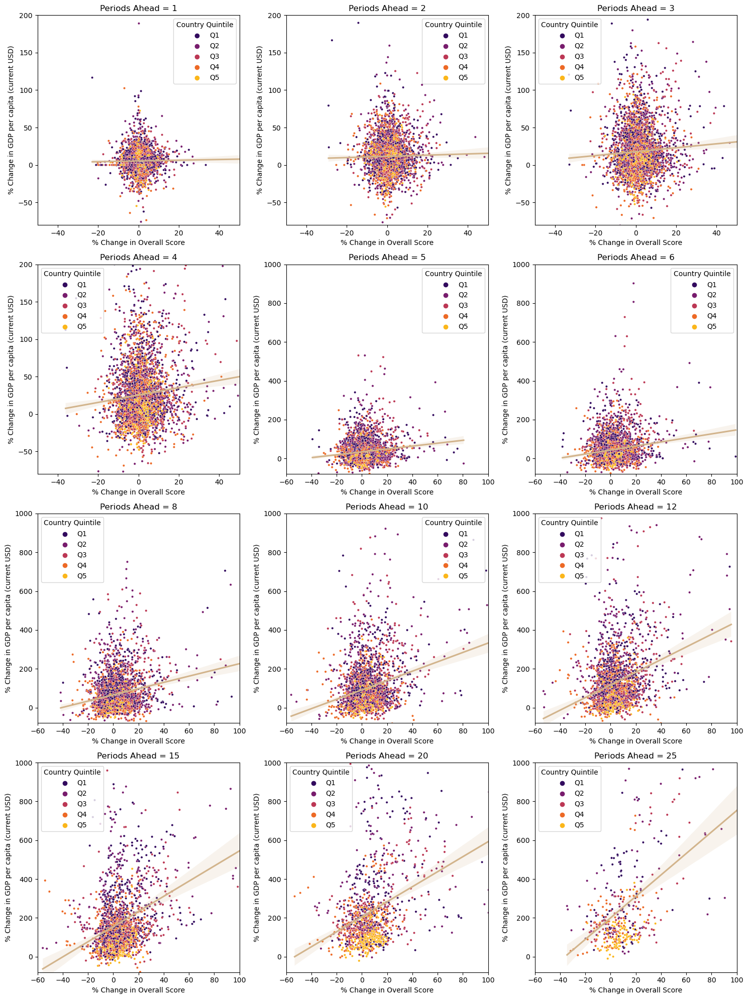




## Property Rights: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.010656,5.363526,0.000330,14.259392
1,2,0.022746,11.547103,0.001078,22.910088
2,3,0.057675,18.317810,0.005306,32.287121
3,4,0.095350,26.806848,0.011032,42.954117
4,5,0.139901,36.805528,0.015135,55.192370
5,6,0.188685,47.955186,0.019540,69.231141
6,8,0.248296,72.962170,0.017912,100.611204
7,10,0.264981,102.651646,0.013069,135.049875
8,12,0.299448,133.982035,0.013020,157.394481
9,15,0.037835,176.325208,0.000160,187.029598


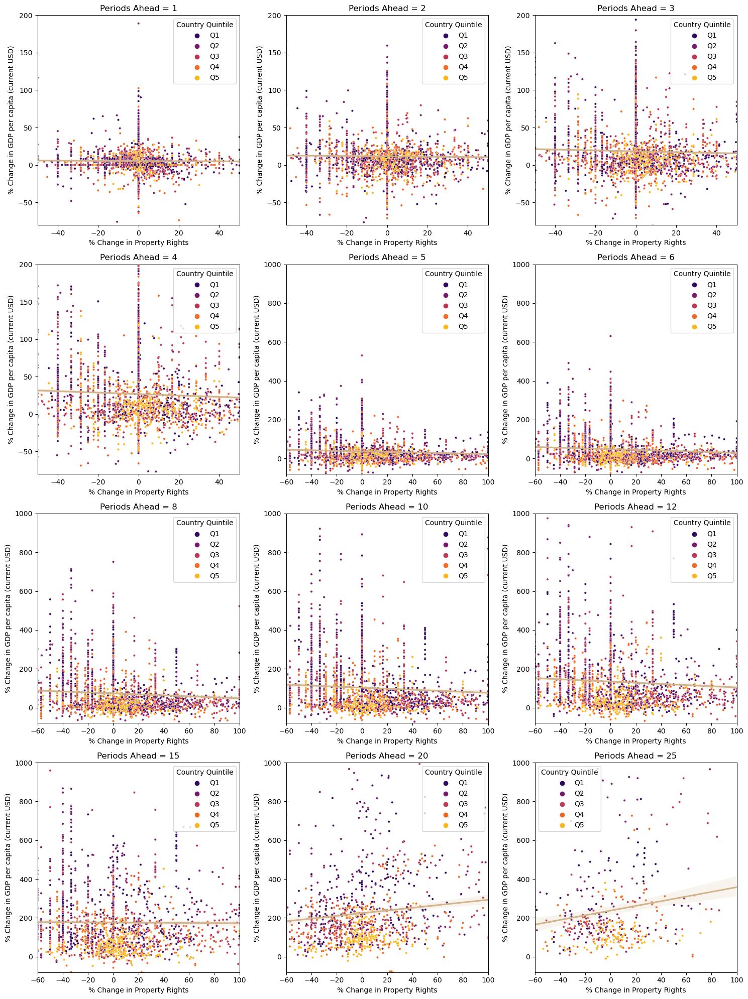




## Government Integrity: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.004784,5.326081,0.000074,14.261214
1,2,0.010041,11.398701,0.000215,22.919985
2,3,0.023155,17.775290,0.000771,32.360643
3,4,0.051759,25.514870,0.002568,43.137542
4,5,0.087485,34.405907,0.005393,55.464669
5,6,0.122686,44.092986,0.007872,69.641883
6,8,0.198279,66.642986,0.012086,100.909226
7,10,0.268407,93.730673,0.015432,134.888104
8,12,0.315163,122.343530,0.019159,156.904206
9,15,0.382397,162.350749,0.027377,184.466405


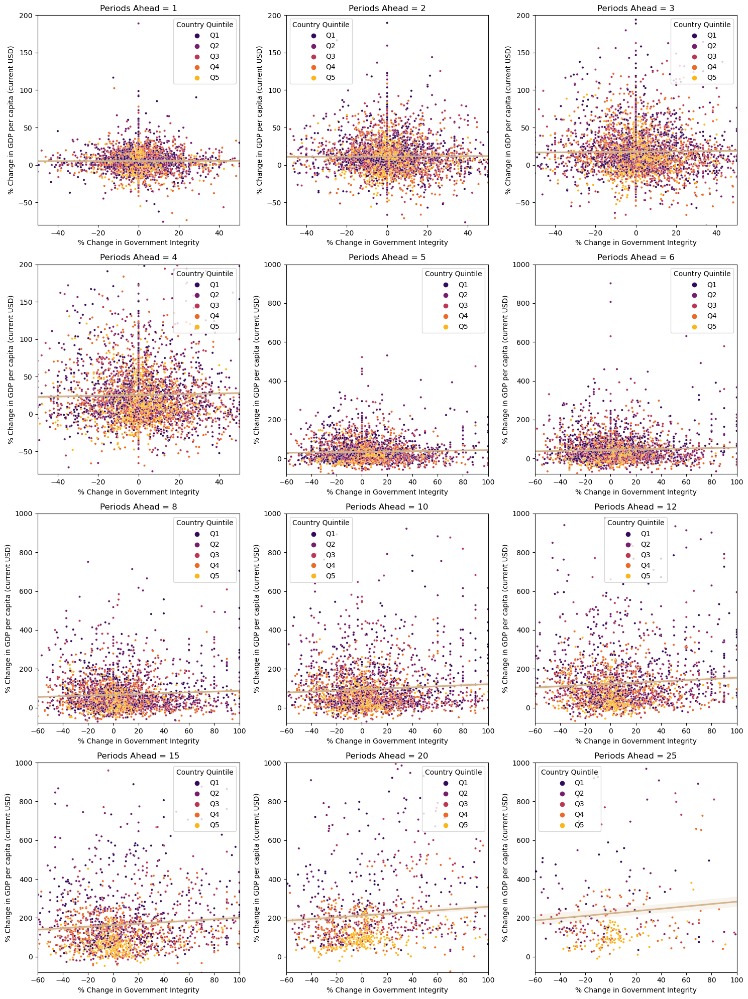




## Judicial Effectiveness: Results
No overlapping data for Judicial Effectiveness with a time delta of 8. Appending NaN values for this delta.
No overlapping data for Judicial Effectiveness with a time delta of 10. Appending NaN values for this delta.
No overlapping data for Judicial Effectiveness with a time delta of 12. Appending NaN values for this delta.
No overlapping data for Judicial Effectiveness with a time delta of 15. Appending NaN values for this delta.
No overlapping data for Judicial Effectiveness with a time delta of 20. Appending NaN values for this delta.
No overlapping data for Judicial Effectiveness with a time delta of 25. Appending NaN values for this delta.


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.013704,2.928255,0.001478,10.645226
1,2,0.048766,5.375276,0.014089,14.853092
2,3,0.033219,4.940445,0.006754,16.963433
3,4,0.060044,6.331581,0.015335,19.678392
4,5,0.034165,13.958507,0.005494,23.206970
5,6,0.039379,17.480872,0.009936,24.256053
6,8,NaN,NaN,NaN,NaN
7,10,NaN,NaN,NaN,NaN
8,12,NaN,NaN,NaN,NaN
9,15,NaN,NaN,NaN,NaN


No data for Judicial Effectiveness with a time delta of 8. Skipping plot for this delta.
No data for Judicial Effectiveness with a time delta of 10. Skipping plot for this delta.
No data for Judicial Effectiveness with a time delta of 12. Skipping plot for this delta.
No data for Judicial Effectiveness with a time delta of 15. Skipping plot for this delta.
No data for Judicial Effectiveness with a time delta of 20. Skipping plot for this delta.
No data for Judicial Effectiveness with a time delta of 25. Skipping plot for this delta.


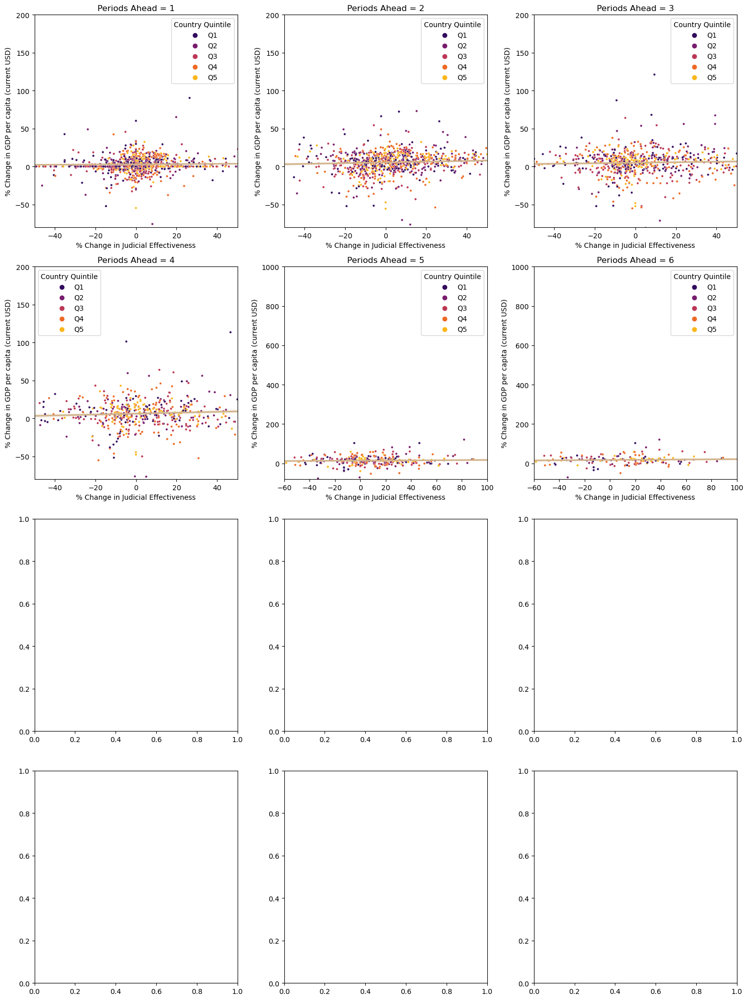




## Government Spending: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.000992,5.363757,1.275727e-04,14.229119
1,2,0.001463,11.521289,2.297750e-04,22.854308
2,3,0.001453,18.079576,1.322693e-04,32.288483
3,4,0.001730,26.218506,2.202460e-04,43.103913
4,5,0.001659,35.734917,1.990522e-04,55.512887
5,6,0.001357,46.216567,1.268132e-04,69.801842
6,8,0.000543,70.967849,9.612167e-06,101.367093
7,10,0.000027,100.735990,1.254548e-08,135.751095
8,12,0.000607,131.968025,5.571437e-06,158.165818
9,15,0.003463,177.230611,1.498283e-04,186.626876


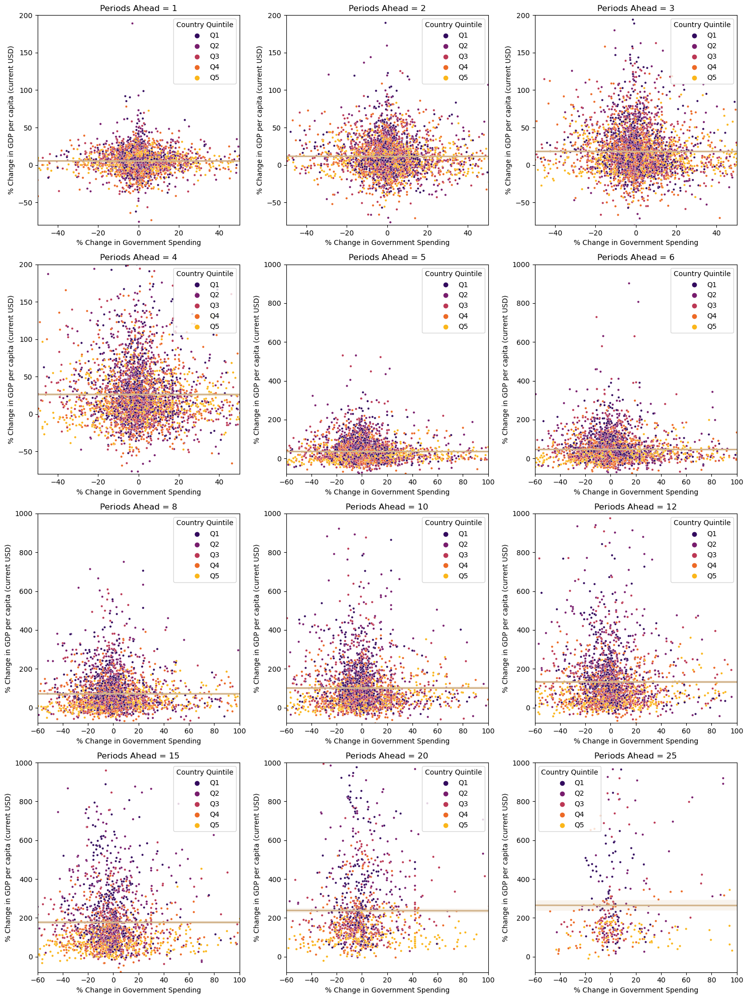




## Tax Burden: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.080066,5.315590,0.001450,14.210712
1,2,0.186748,11.225505,0.005694,22.770076
2,3,0.290541,17.344431,0.010564,32.093190
3,4,0.394151,24.814798,0.014609,42.782781
4,5,0.492888,33.484225,0.017084,55.035817
5,6,0.640697,42.671502,0.021150,69.057771
6,8,0.858398,64.606172,0.023183,100.166130
7,10,1.084430,90.615166,0.025678,134.008352
8,12,1.287941,117.557259,0.031924,155.626920
9,15,1.297630,158.800285,0.029849,183.774424


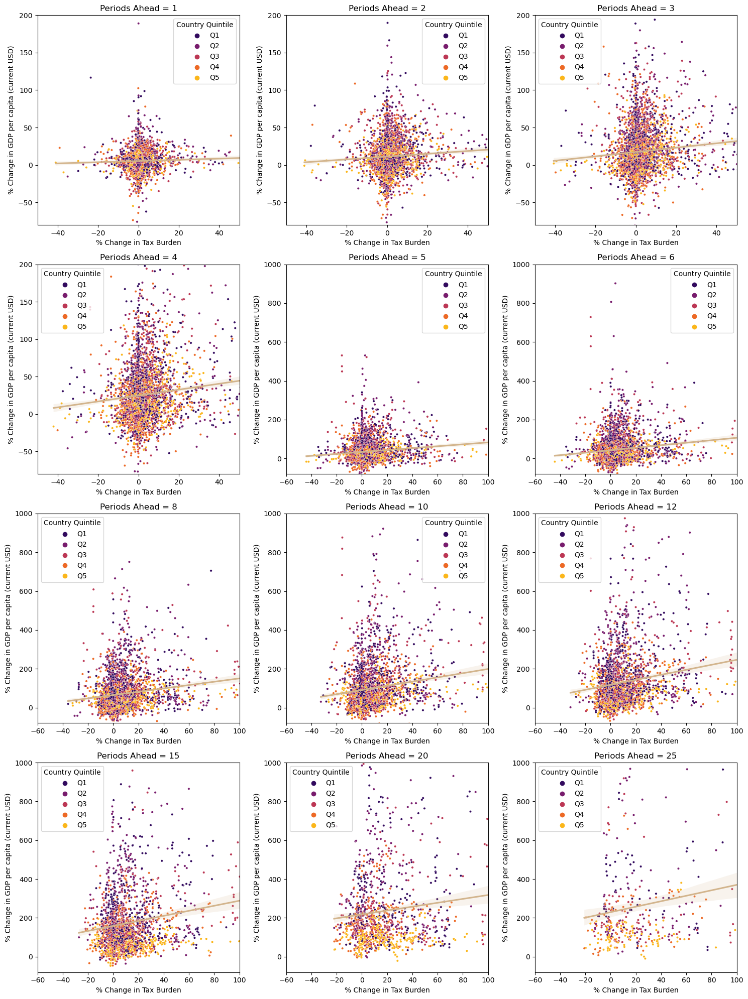




## Fiscal Health: Results
No overlapping data for Fiscal Health with a time delta of 8. Appending NaN values for this delta.
No overlapping data for Fiscal Health with a time delta of 10. Appending NaN values for this delta.
No overlapping data for Fiscal Health with a time delta of 12. Appending NaN values for this delta.
No overlapping data for Fiscal Health with a time delta of 15. Appending NaN values for this delta.
No overlapping data for Fiscal Health with a time delta of 20. Appending NaN values for this delta.
No overlapping data for Fiscal Health with a time delta of 25. Appending NaN values for this delta.


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.001566,3.012499,0.004050,10.512105
1,2,0.001094,5.812439,0.001354,14.722054
2,3,0.000273,5.424422,0.000028,16.706199
3,4,0.000183,7.134165,0.000014,19.592709
4,5,0.000577,14.683048,0.000107,23.095537
5,6,0.000333,18.477269,0.000024,24.277640
6,8,NaN,NaN,NaN,NaN
7,10,NaN,NaN,NaN,NaN
8,12,NaN,NaN,NaN,NaN
9,15,NaN,NaN,NaN,NaN


No data for Fiscal Health with a time delta of 8. Skipping plot for this delta.
No data for Fiscal Health with a time delta of 10. Skipping plot for this delta.
No data for Fiscal Health with a time delta of 12. Skipping plot for this delta.
No data for Fiscal Health with a time delta of 15. Skipping plot for this delta.
No data for Fiscal Health with a time delta of 20. Skipping plot for this delta.
No data for Fiscal Health with a time delta of 25. Skipping plot for this delta.


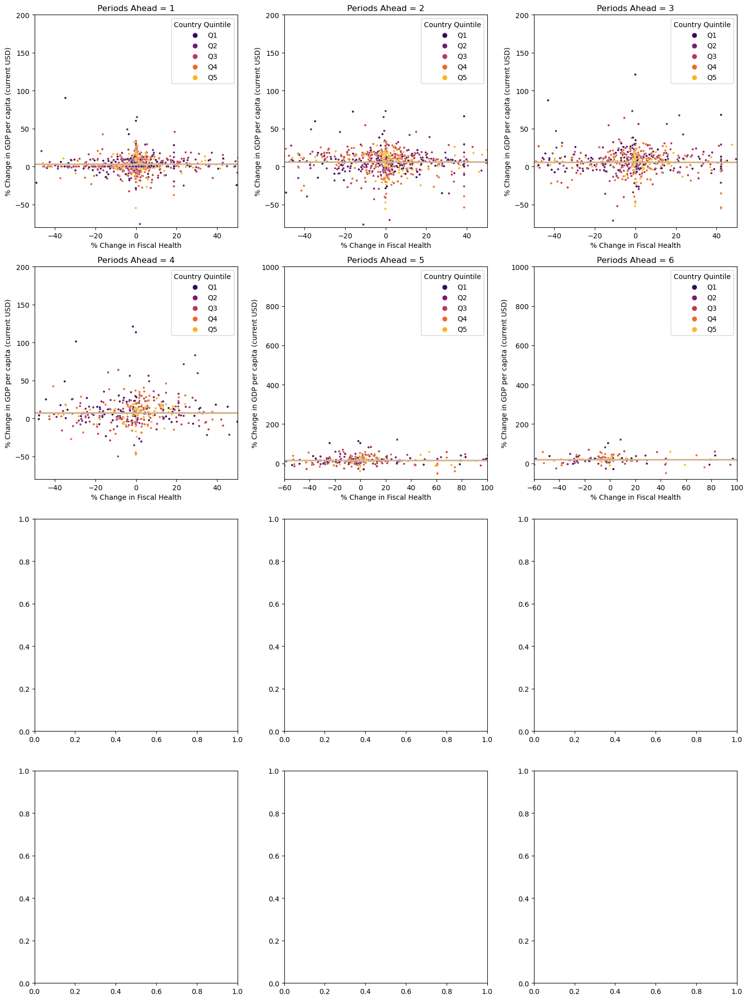




## Business Freedom: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.015468,5.341131,0.000091,14.261095
1,2,0.046859,11.447214,0.000589,22.915700
2,3,0.110393,17.915983,0.002420,32.333931
3,4,0.144717,25.937308,0.003191,43.124060
4,5,0.190914,35.290621,0.004267,55.496050
5,6,0.234602,45.578781,0.004946,69.744485
6,8,0.296235,69.869502,0.004968,101.272076
7,10,0.349452,99.142997,0.004628,135.626182
8,12,0.540405,129.336415,0.008346,157.766713
9,15,0.890731,172.587900,0.015775,185.563365


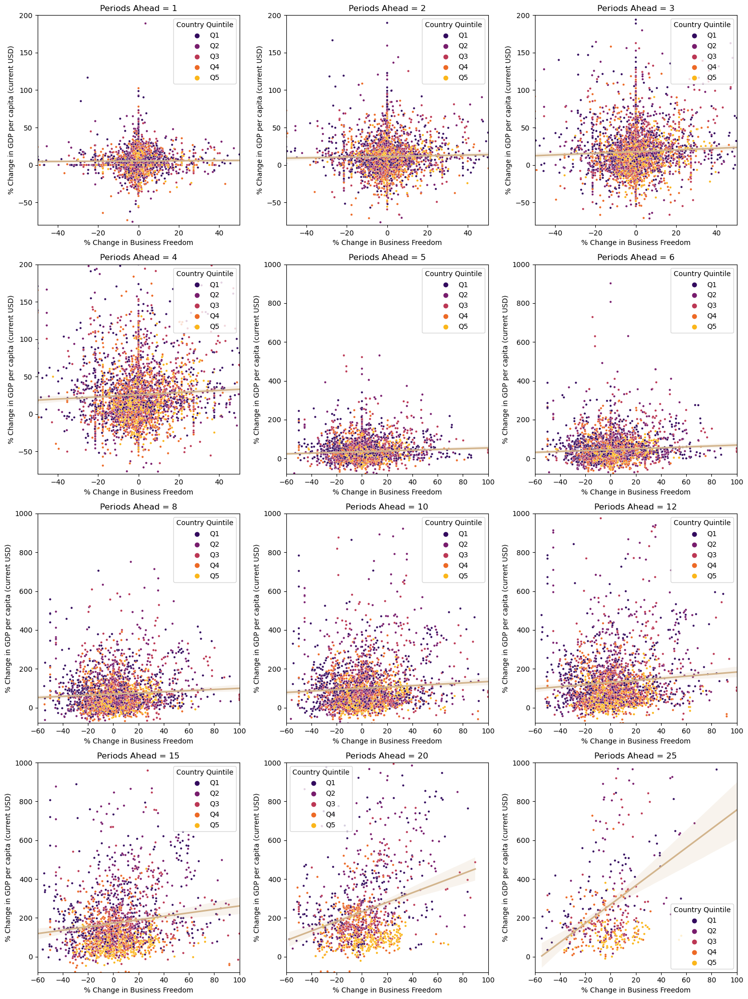




## Monetary Freedom: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.018442,5.318250,0.000293,14.259656
1,2,0.012716,11.429683,0.000123,22.921044
2,3,0.066312,17.754630,0.002284,32.336133
3,4,0.140500,25.465017,0.007332,43.034403
4,5,0.208153,34.473369,0.012251,55.273104
5,6,0.252780,44.471690,0.014582,69.405959
6,8,0.402167,67.848101,0.023482,100.325513
7,10,0.603432,95.809141,0.035138,133.531385
8,12,0.865563,124.366574,0.057596,153.799078
9,15,0.646961,169.092698,0.041191,183.151767


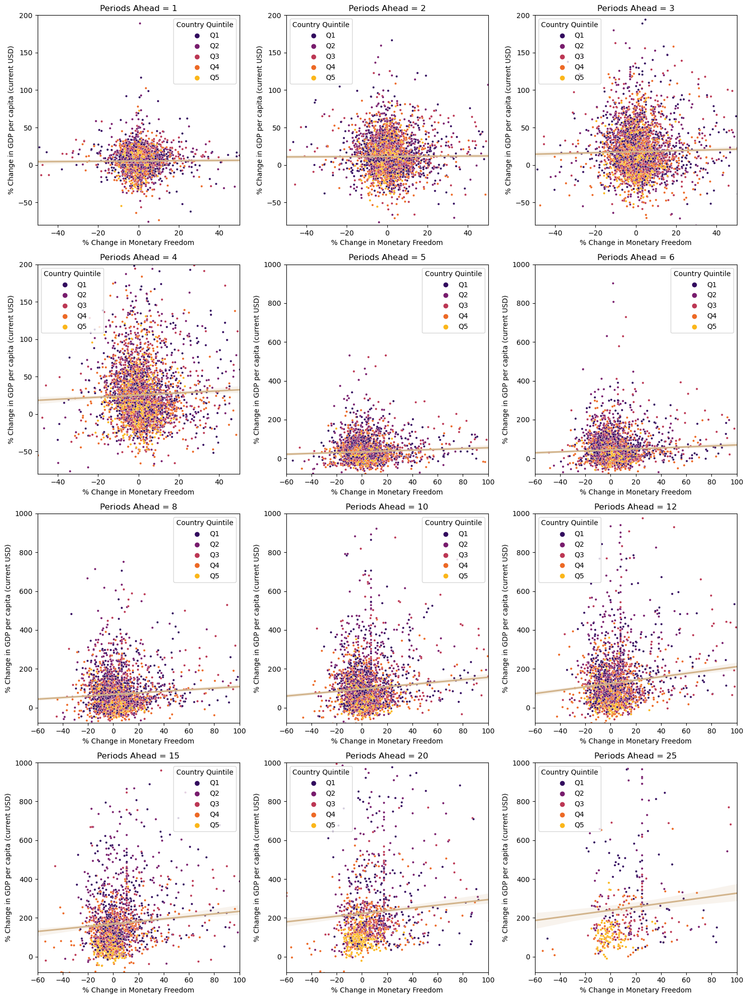




## Labor Freedom: Results
No overlapping data for Labor Freedom with a time delta of 20. Appending NaN values for this delta.
No overlapping data for Labor Freedom with a time delta of 25. Appending NaN values for this delta.


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.004963,4.992771,1.471284e-05,13.152330
1,2,0.012489,10.372943,7.179251e-05,21.451269
2,3,0.000402,15.077109,5.946066e-08,29.136715
3,4,0.009224,19.882314,2.639263e-05,36.539949
4,5,0.055988,23.909543,9.476716e-04,40.900941
5,6,0.097257,29.370206,2.241674e-03,49.832834
6,8,0.199301,38.565793,7.048311e-03,65.936344
7,10,0.317322,48.732011,1.740259e-02,74.050758
8,12,0.366668,62.965257,1.859126e-02,80.423155
9,15,0.562934,97.667729,2.254263e-02,107.382012


No data for Labor Freedom with a time delta of 20. Skipping plot for this delta.
No data for Labor Freedom with a time delta of 25. Skipping plot for this delta.


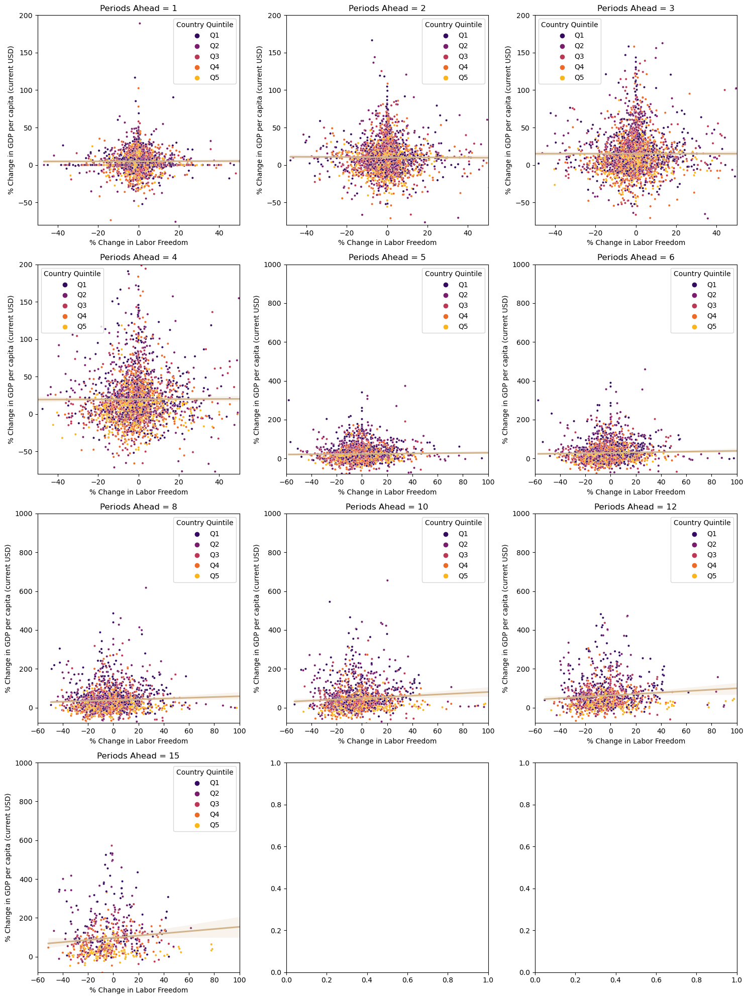




## Financial Freedom: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.024256,5.346668,0.000886,14.225705
1,2,0.054684,11.392970,0.003603,22.813417
2,3,0.104044,17.721373,0.010458,32.140649
3,4,0.149056,25.545517,0.016337,42.812781
4,5,0.199815,34.576687,0.023804,54.935539
5,6,0.263757,44.377644,0.031913,68.778955
6,8,0.392409,67.665447,0.041115,99.369551
7,10,0.508548,96.307086,0.038164,133.233894
8,12,0.475313,127.697381,0.025361,156.265686
9,15,0.295821,173.842671,0.008321,186.032799


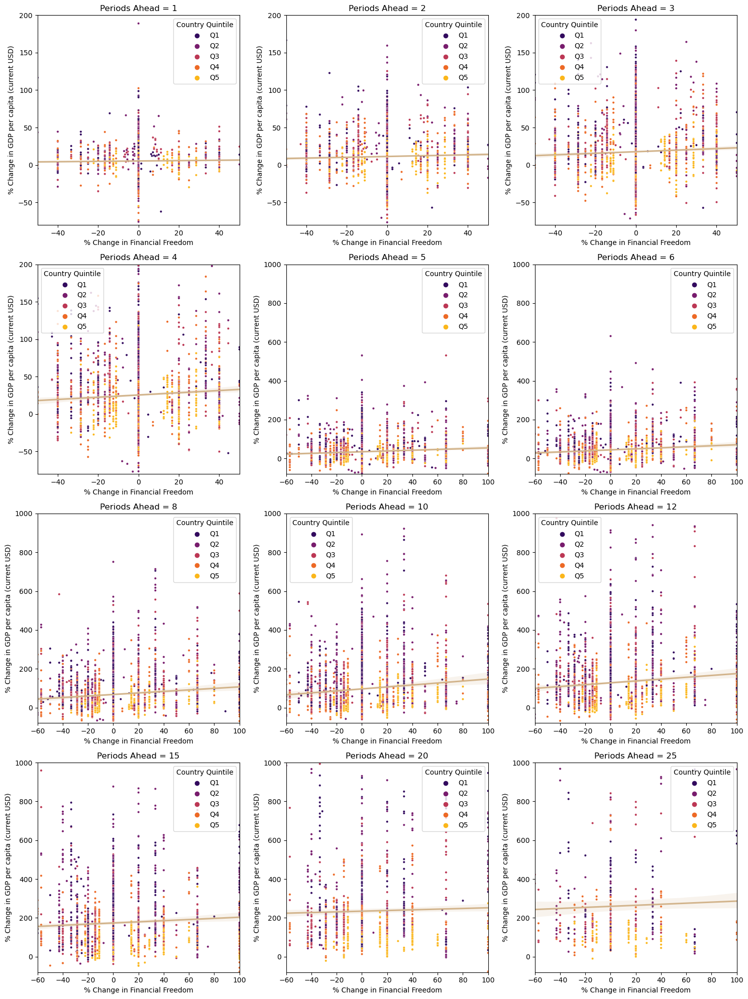




## Investment Freedom: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.006045,5.354304,0.000055,14.263858
1,2,0.019790,11.520723,0.000437,22.921196
2,3,0.046606,18.177429,0.001939,32.348777
3,4,0.064858,26.415578,0.002705,43.145720
4,5,0.103495,36.217334,0.005069,55.483691
5,6,0.137750,47.038834,0.006811,69.683205
6,8,0.210335,72.678468,0.010046,101.005142
7,10,0.226295,102.826357,0.007819,135.404145
8,12,0.200991,133.833446,0.005205,158.009504
9,15,0.101703,174.357685,0.001175,186.822636


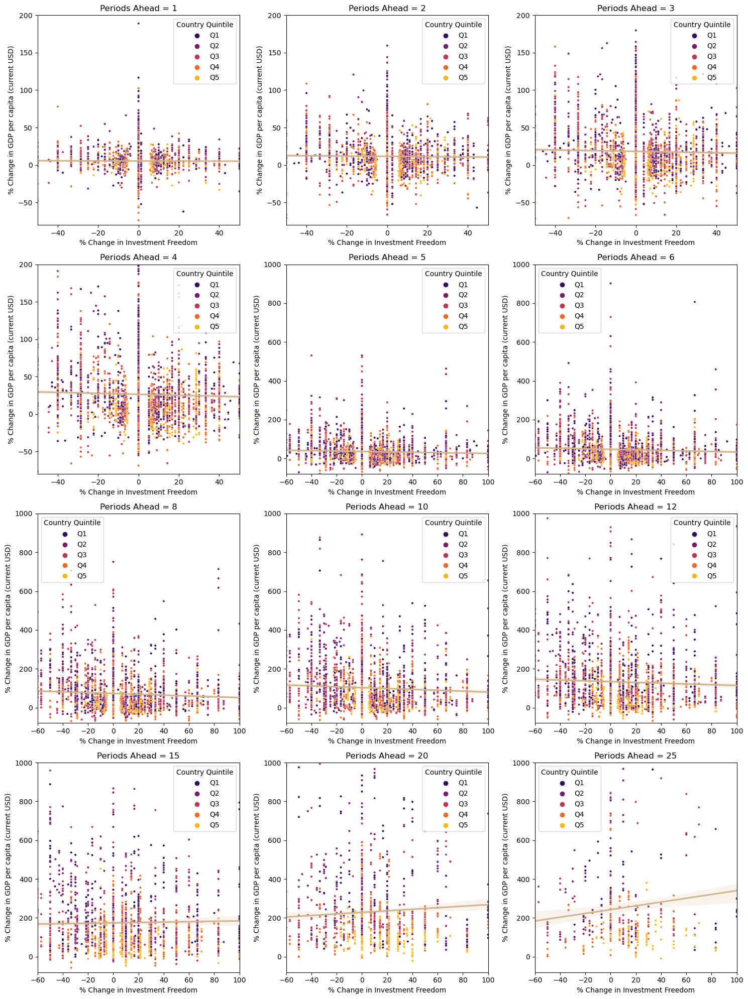




## Trade Freedom: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.003462,5.355699,0.000019,14.256400
1,2,0.041302,11.365129,0.001719,22.886931
2,3,0.094685,17.563505,0.005823,32.265134
3,4,0.149230,25.133054,0.009886,42.981802
4,5,0.197741,33.901007,0.012610,55.283684
5,6,0.256418,43.354247,0.015579,69.396798
6,8,0.384447,65.215279,0.021046,100.464616
7,10,0.455261,92.012307,0.020365,134.546718
8,12,0.500588,120.103776,0.021580,156.692850
9,15,0.403557,164.563735,0.011826,185.803356


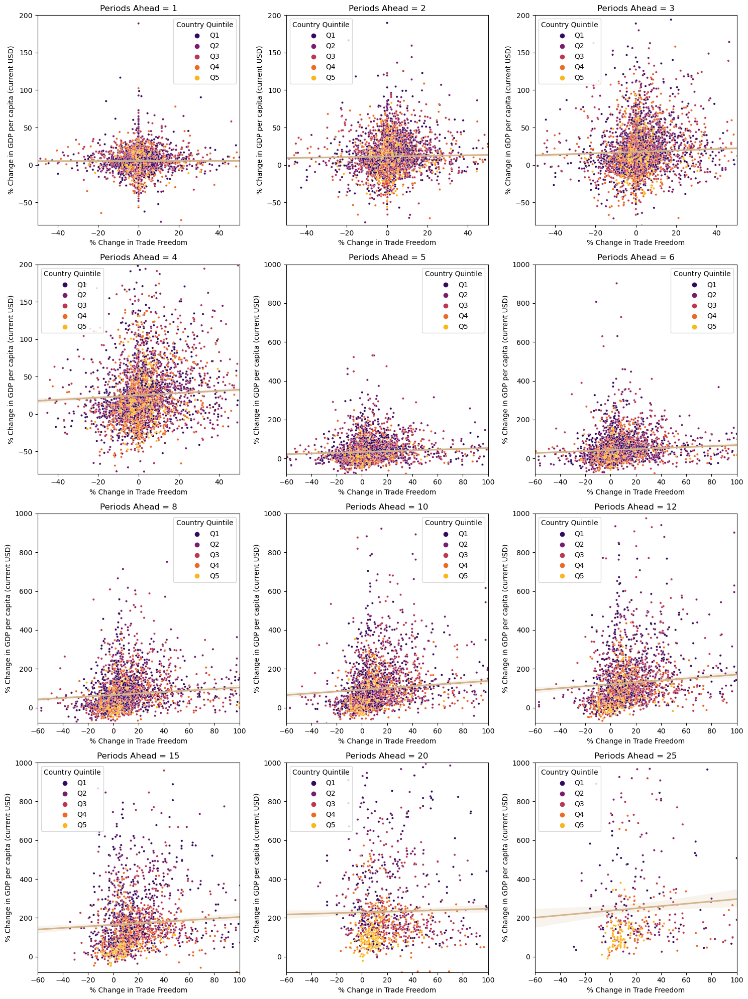




## Rule of Law: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.008652,5.353145,0.000065,14.261282
1,2,0.023704,11.518821,0.000348,22.918458
2,3,0.058373,18.192253,0.001618,32.346937
3,4,0.092423,26.504398,0.002939,43.129520
4,5,0.112807,36.205382,0.003342,55.521832
5,6,0.129136,46.881646,0.003305,69.801971
6,8,0.158910,71.894873,0.002955,101.374472
7,10,0.113436,101.192965,0.000995,135.873405
8,12,0.086522,132.042277,0.000522,158.387829
9,15,0.249627,172.871101,0.004569,186.616772


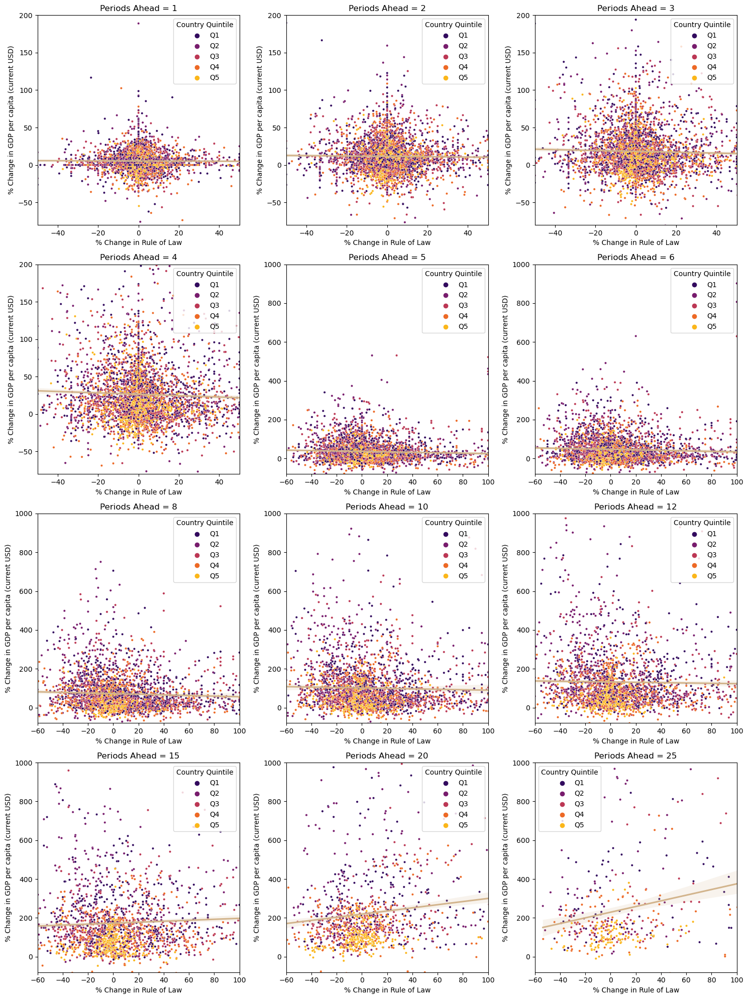




## Limited Government: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.036798,5.337614,0.000674,14.227757
1,2,0.014510,11.470701,0.000088,22.889815
2,3,0.039759,17.914269,0.000506,32.316164
3,4,0.085018,25.808347,0.001663,43.121057
4,5,0.149601,34.963110,0.003543,55.474051
5,6,0.235309,44.919572,0.006023,69.667360
6,8,0.420453,68.402205,0.010503,100.939950
7,10,0.554588,96.926644,0.011592,135.071624
8,12,0.626190,127.053632,0.013416,157.239980
9,15,0.561415,171.739759,0.009014,186.009032


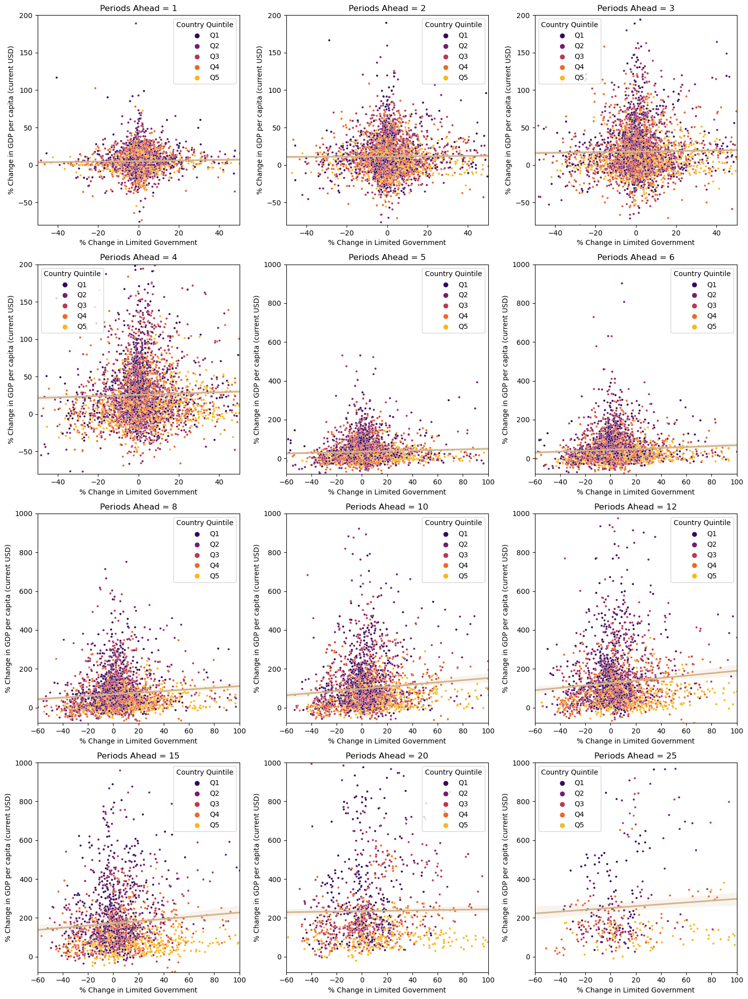




## Regulatory Efficiency: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.039894,5.359375,0.000534,14.257936
1,2,0.060656,11.526795,0.001117,22.909645
2,3,0.017298,17.940081,0.000073,32.371950
3,4,0.088352,25.856226,0.001399,43.162815
4,5,0.204632,34.996988,0.005494,55.461837
5,6,0.349103,44.979018,0.011683,69.507972
6,8,0.764122,68.202200,0.034362,99.765020
7,10,1.383632,95.557331,0.075223,130.728185
8,12,1.927993,123.802849,0.126504,148.069515
9,15,2.270420,164.361865,0.168825,170.526277


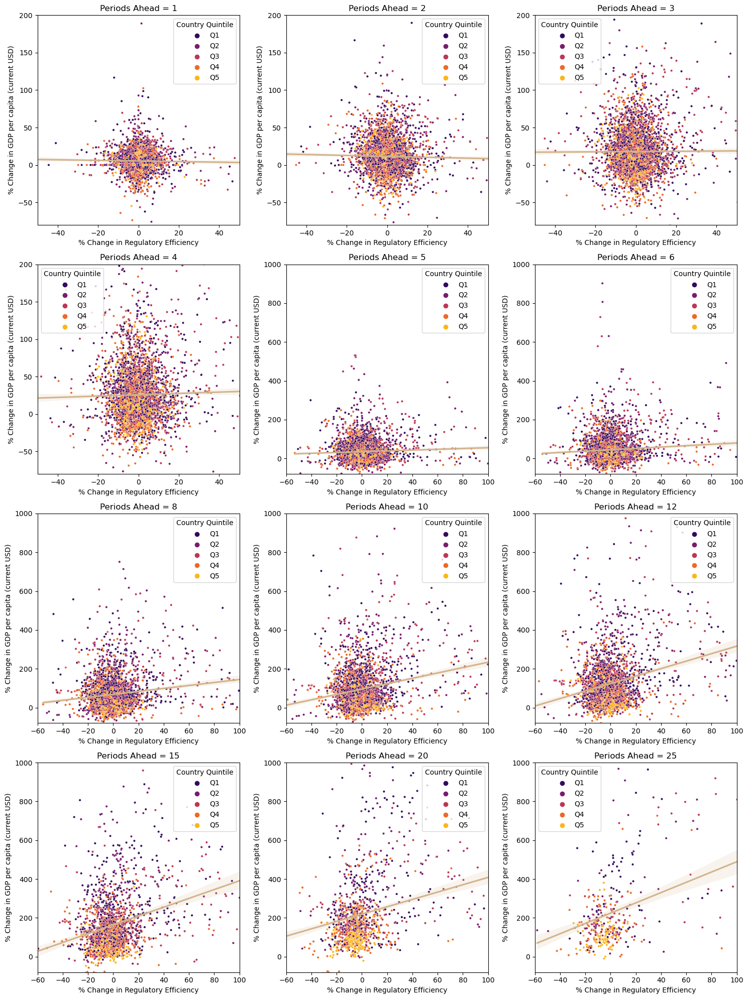




## Open Markets: Results


,Years Ahead,Coefficient (target to predictor % Change),Intercept,R^2 Score,RMSE
0,1,0.016312,5.331866,0.000101,14.262178
1,2,0.083463,11.334727,0.001851,22.903001
2,3,0.150250,17.623576,0.004231,32.308933
3,4,0.198928,25.413231,0.005357,43.084886
4,5,0.251561,34.443056,0.006239,55.451422
5,6,0.333127,44.183068,0.008045,69.643003
6,8,0.518363,66.938440,0.011125,100.958266
7,10,0.684778,94.421505,0.011810,135.135956
8,12,0.784561,123.457217,0.012333,157.449250
9,15,0.814286,165.976396,0.010962,185.912990


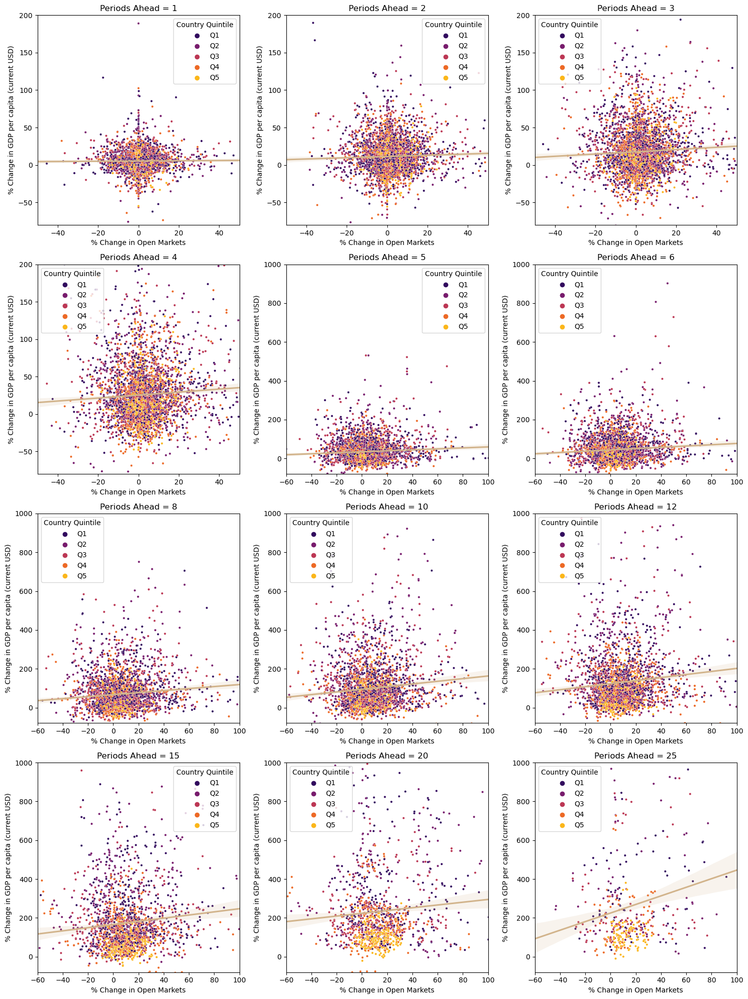

In [8]:
# Create an empty DataFrame to store coefficients and R^2 scores for year 6
summaryData = pd.DataFrame(columns=['Predictor', 'Coefficient (Year 6)', 'R^2 Score (Year 6)', 'RMSE (Year 6)'])

# Initialize another DataFrame to store the raw data, for later exporting
export_df = df_base[[
    'Country Name',
    'Index Year',
    'GDP per capita (current USD)',
    'Country Quintile']].dropna().copy()

polyOrder = 1
toExportData = False

# Loop through each predictor
for predictor in predictors:
    print(f"## {predictor}: Results")
    regression_results, df_withDeltas \
            = TimeSeriesGrowthAnalysis(df_base, polyOrder = polyOrder, timePeriods_delta=years_delta, predictor=predictor)

    # Extract the coefficient and R^2 score for year 6 
    year6_data = regression_results[regression_results['Years Ahead'] == 6]
    coeff_for_year6 = year6_data['Coefficient (target to predictor % Change)'].values
    r2_for_year6 = year6_data['R^2 Score'].values
    RMSE_for_year6 = year6_data['RMSE'].values
    
    # If True, add data to DataFrame, for later exporting
    if toExportData:
        
        # Exclude these columns to prevent duplication during merge
        exclude_keywords = ['GDP per capita (current USD)', 'Country Quintile', 'Country Name', 'Index Year']
        
        # Determine which columns from df_withDeltas are new and not already in export_df
        new_cols_to_merge = [col for col in df_withDeltas.columns if col not in exclude_keywords and col not in export_df.columns]
        
        # Only merge the new columns to avoid duplication
        export_df = pd.merge(
            export_df,
            df_withDeltas[new_cols_to_merge + ['Country Name', 'Index Year']],
            on=['Country Name', 'Index Year'],
            how='left'
        )
    
    # Append to the DataFrame
    new_row = pd.DataFrame({
        'Predictor': predictor, 
        'Coefficient (Year 6)': coeff_for_year6,
        'R^2 Score (Year 6)': r2_for_year6,
        'RMSE (Year 6)': RMSE_for_year6
    })
    summaryData = pd.concat([summaryData, new_row], ignore_index=True)

    # Display regression results
    display(regression_results)

    # Plot the analysis
    PlotTimeSeriesGrowthAnalysis(df_withDeltas, 
                             timePeriods_delta=years_delta, 
                             predictor=predictor,
                             polyOrder = polyOrder
                             )

    print("\n\n")

### Summary

In [9]:
summaryData = summaryData.round(3)
summaryData.sort_values(by='R^2 Score (Year 6)')

,Predictor,Coefficient (Year 6),R^2 Score (Year 6),RMSE (Year 6)
4,Government Spending,0.001,0.000,69.802
6,Fiscal Health,0.000,0.000,24.278
9,Labor Freedom,0.097,0.002,49.833
13,Rule of Law,0.129,0.003,69.802
7,Business Freedom,0.235,0.005,69.744
14,Limited Government,0.235,0.006,69.667
11,Investment Freedom,0.138,0.007,69.683
16,Open Markets,0.333,0.008,69.643
2,Government Integrity,0.123,0.008,69.642
3,Judicial Effectiveness,0.039,0.010,24.256


### Thoughts

As you can see by looking at the summary and the charts, it is evident that certain predictors show a notable correlation in terms of magnitude as the delta rises. However, when evaluating precision, the relevance seems minimal—most instances report an _R²_ value of merely 4% even over a 25-year span.

This observed trend could be influenced by [Simpson's Paradox](https://en.wikipedia.org/wiki/Simpson%27s_paradox). But when analyzing specific quintiles using the same methodologies, the outcomes largely mirror the overall findings.

Additionally, the graphical representation of some predictors closely resembles a normal distribution. This suggests that certain variables might be interrelated due to random chance rather than any useful connection.

While expecting a singular predictor to effectively forecast future GDP growth is unrealistic, evaluating each predictor separately reinforces our preliminary observation from the '02_EDA_01_SimplePlots' Notebook, which states: *"Certain elements of Economic Freedom carry more weight than others."*


## Next Step
Our forthcoming step involves investigating the potential of crafting a predictive model for future GDP growth by utilizing all predictors ***in tandem***.

In [10]:
if toExportData:
    export_df.to_csv(f"..\Data_Sets\processed\economicData_EF-Analysis_{years_delta[0]}yearsDelta.csv")